In [9]:
import scanpy as sc
import scvelo as scv
import anndata
import pandas as pd
import cellrank as cr
import numpy as np
import scachepy

np.random.seed(42)

scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo', frameon=True)
cr.settings.verbosity = 2

In [10]:
print("# Loading from 'create_caches.py'")
adata_w_velo = scv.read("./data/meso_data_w_velo.h5ad")


# Loading from 'create_caches.py'


Cytovelo output has all of the cells, not just the ones in the epi that passed QC.


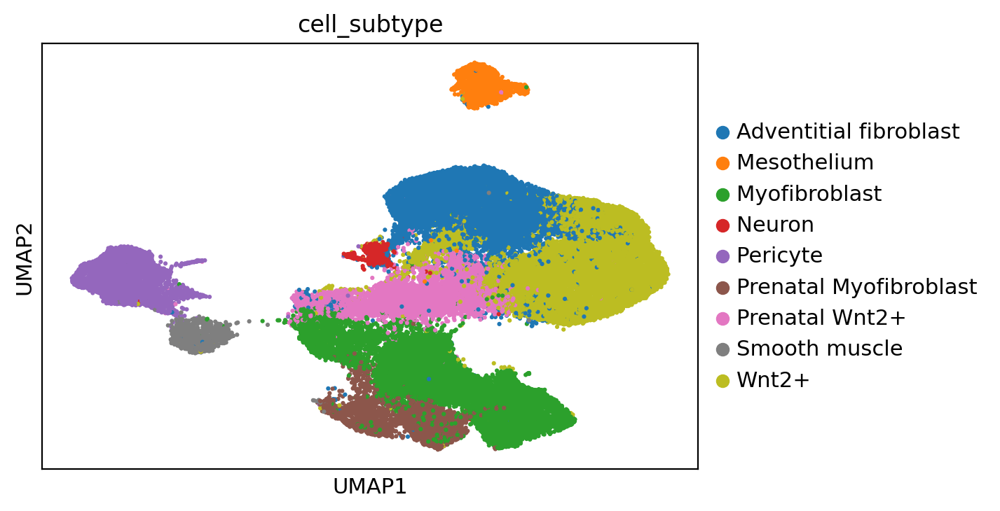

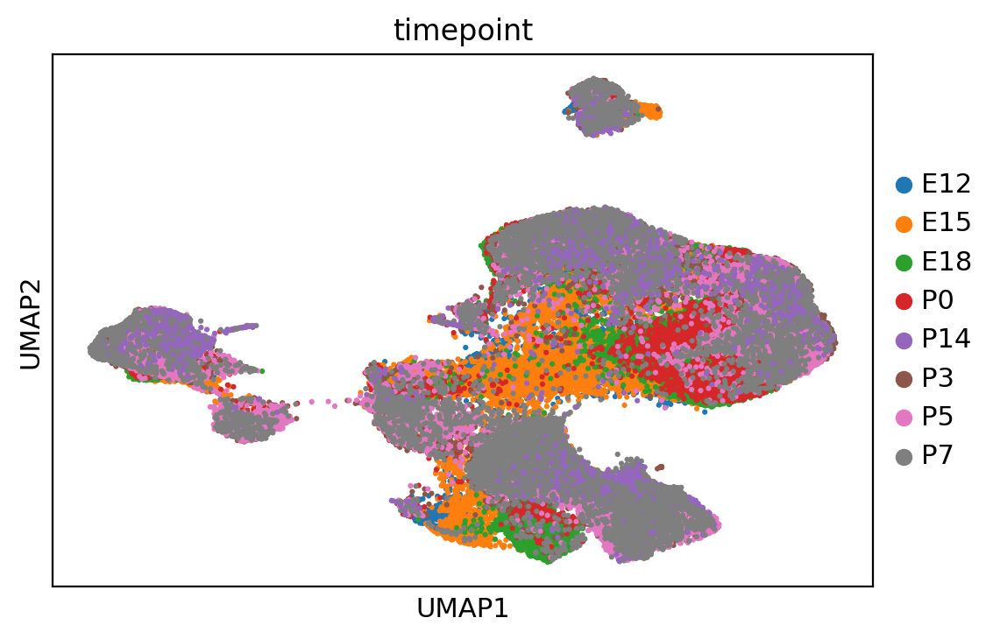

In [11]:
sc.pl.umap(adata_w_velo, color = 'cell_subtype', size = 20)
sc.pl.umap(adata_w_velo, color = 'timepoint', size = 20)

## Run scVelo

Starting partway through the tutorial - normalization and PCA and UMAP is already done.

In [12]:
adata_w_velo

AnnData object with n_obs × n_vars = 58560 × 21781
    obs: 'timepoint', 'bulk_cellype', 'cell_subtype', 'sample_batch', 'Clusters', '_X', '_Y', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size'
    uns: 'cell_subtype_colors', 'timepoint_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [13]:
# must use the same settings as in 'create_caches.py'
scv.pp.moments(adata_w_velo, n_pcs=30, n_neighbors=30)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:01:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:01:43) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [14]:
adata_w_velo

AnnData object with n_obs × n_vars = 58560 × 21781
    obs: 'timepoint', 'bulk_cellype', 'cell_subtype', 'sample_batch', 'Clusters', '_X', '_Y', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    uns: 'cell_subtype_colors', 'timepoint_colors', 'pca', 'neighbors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced', 'Ms', 'Mu'
    obsp: 'distances', 'connectivities'

In [15]:
#adata_w_velo.write("./meso_adata_for_obsp.h5ad", compression = 'gzip')

In [16]:
c = scachepy.Cache('./cache/cellrank')
c.tl.recover_dynamics(adata_w_velo) # scv

Loading data from: `recover_dynamics.pickle`.


In [17]:
c.tl.velocity(adata_w_velo, mode='dynamical') # scv
c.tl.velocity_graph(adata_w_velo) # scv


Loading data from: `velo.pickle`.
`adata.var` already contains key: `'fit_beta'`.
`adata.var` already contains key: `'fit_gamma'`.
`adata.var` already contains key: `'velocity_genes'`.
Loading data from: `velo_graph.pickle`.
`adata.uns` already contains key: `'velocity_graph_neg'`.


computing velocity embedding
    finished (0:01:24) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_meso_stream_draft.png


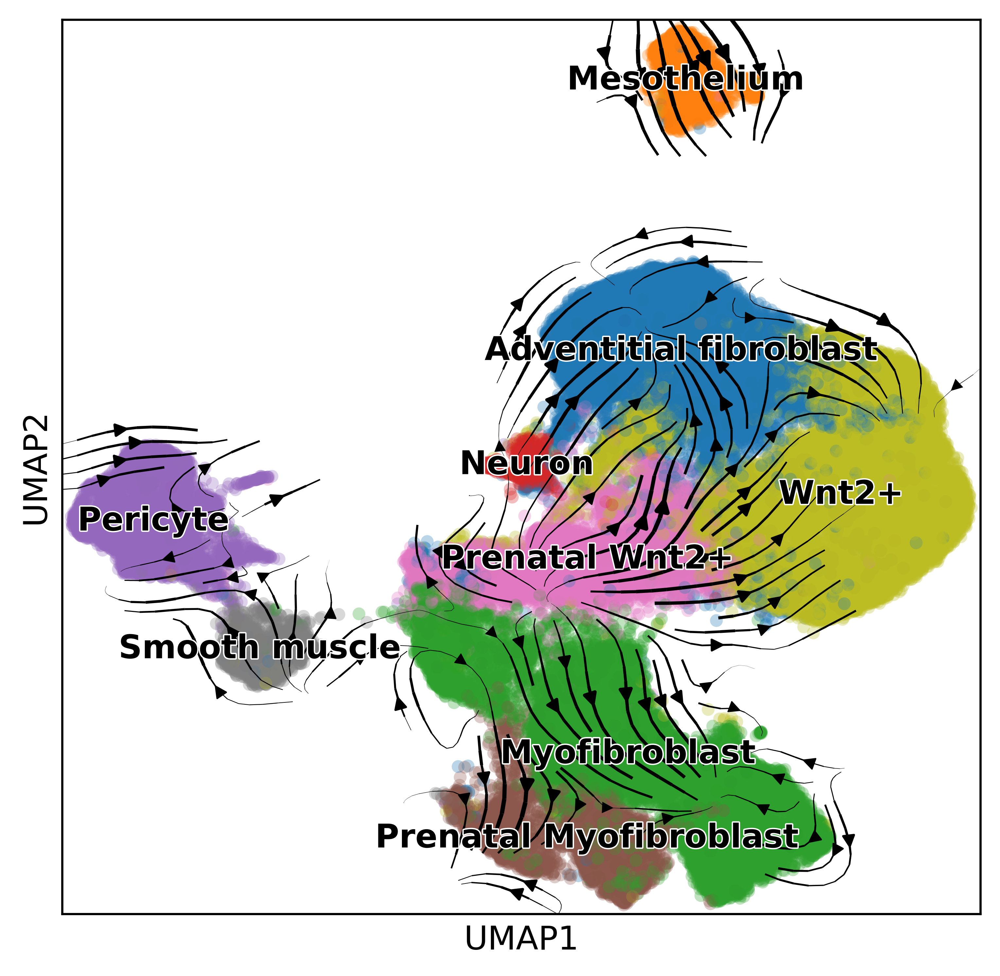

In [18]:
scv.pl.velocity_embedding_stream(adata_w_velo,
                                 basis='umap',
                                 legend_fontsize=12,
                                 title='', smooth=.8, min_mass=2,
                                 color = 'cell_subtype',
                                 figsize = (6,6),
                                 save = 'meso_stream_draft.png',
                                 dpi = 300)


## SCV
More scvelo - figure out of the different clusters have different kintics.

In [19]:
n_var_genes = 200
adata_w_velo.var['fit_likelihood'].sort_values(ascending=False).index[:n_var_genes]

Index(['Egr1', 'Dcn', 'Cd34', 'Uba52', 'Aurkb', 'Eln', 'Cdk4', 'Cald1',
       'Egfem1', 'Ppia',
       ...
       'Fam105a', 'Lsm2', 'Pdgfrb', 'Igf1', 'Pik3r1', 'Gng11', 'Igf2bp3',
       'Nop10', 'Fscn1', 'Robo1'],
      dtype='object', length=200)

In [20]:
top_genes = adata_w_velo.var['fit_likelihood'].sort_values(ascending=False).index[:n_var_genes]
scv.tl.differential_kinetic_test(adata_w_velo, var_names=top_genes, groupby='cell_subtype')

testing for differential kinetics
    finished (0:14:27) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pval_kinetics', p-values of differential kinetics (adata.var)


In [21]:
scv.get_df(adata_w_velo[:, top_genes], ['fit_diff_kinetics', 'fit_pval_kinetics'], precision=2)

,fit_diff_kinetics,fit_pval_kinetics
Egr1,Prenatal Myofibr,3.40e-08
Cd34,Adventitial fibr,1.95e-16
Aurkb,Myofibroblast,1.40e-04
Eln,Adventitial fibr,2.48e-10
Cdk4,Prenatal Wnt2+,4.09e-29
...,...,...
Igf1,Prenatal Myofibr,9.84e-96
Pik3r1,"Pericyte,Prenata",2.11e-06
Igf2bp3,Adventitial fibr,1.15e-04
Nop10,Prenatal Wnt2+,1.01e-102


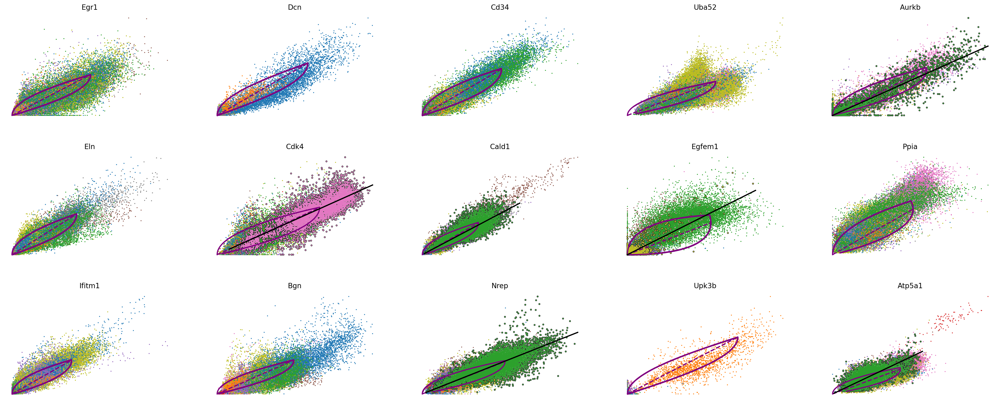

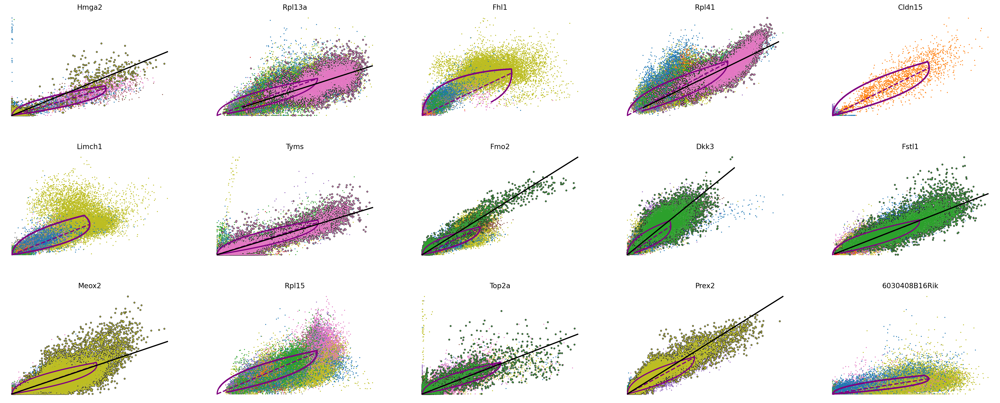

In [22]:
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)
scv.pl.scatter(adata_w_velo, basis=top_genes[:15], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

scv.pl.scatter(adata_w_velo, basis=top_genes[15:30], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

In [23]:
c.tl.velocity(adata_w_velo, diff_kinetics=True, mode='dynamical', fname='velo_diff_kinetics') # scv

Loading data from: `velo_diff_kinetics.pickle`.
`adata.var` already contains key: `'velocity_genes'`.
`adata.layers` already contains key: `'velocity'`.
`adata.layers` already contains key: `'velocity_u'`.
`adata.var` already contains key: `'fit_beta'`.
`adata.var` already contains key: `'fit_gamma'`.
`adata.var` already contains key: `'fit_r2'`.
`adata.var` already contains key: `'velocity_genes'`.


In [24]:
c.tl.velocity_graph(adata_w_velo, fname='velo_graph_diff_kinetics')

Loading data from: `velo_graph_diff_kinetics.pickle`.
`adata.uns` already contains key: `'velocity_graph'`.
`adata.uns` already contains key: `'velocity_graph_neg'`.
`adata.uns` already contains key: `'velocity_graph_neg'`.
`adata.obs` already contains key: `'velocity_self_transition'`.


In [25]:
adata_w_velo.obs['cell_subtype'].cat.categories
adata_w_velo.uns['cell_subtype_colors'] = ["#2ca02c", # Dark green
                                           "#d62728", # Dark red
                                           "#ffbb78", # Light orange
                                           "#9467bd", # Light purple
                                           "#98df8a", # Light green
                                           "#ff7f0e", # Dark orange
                                           "#1f77b4", # Dark blue
                                           "#ff9896", # Light red
                                           "#aec7e8", # Light blue
                                          ]

saving figure to file ./figures/scvelo_velocity.png


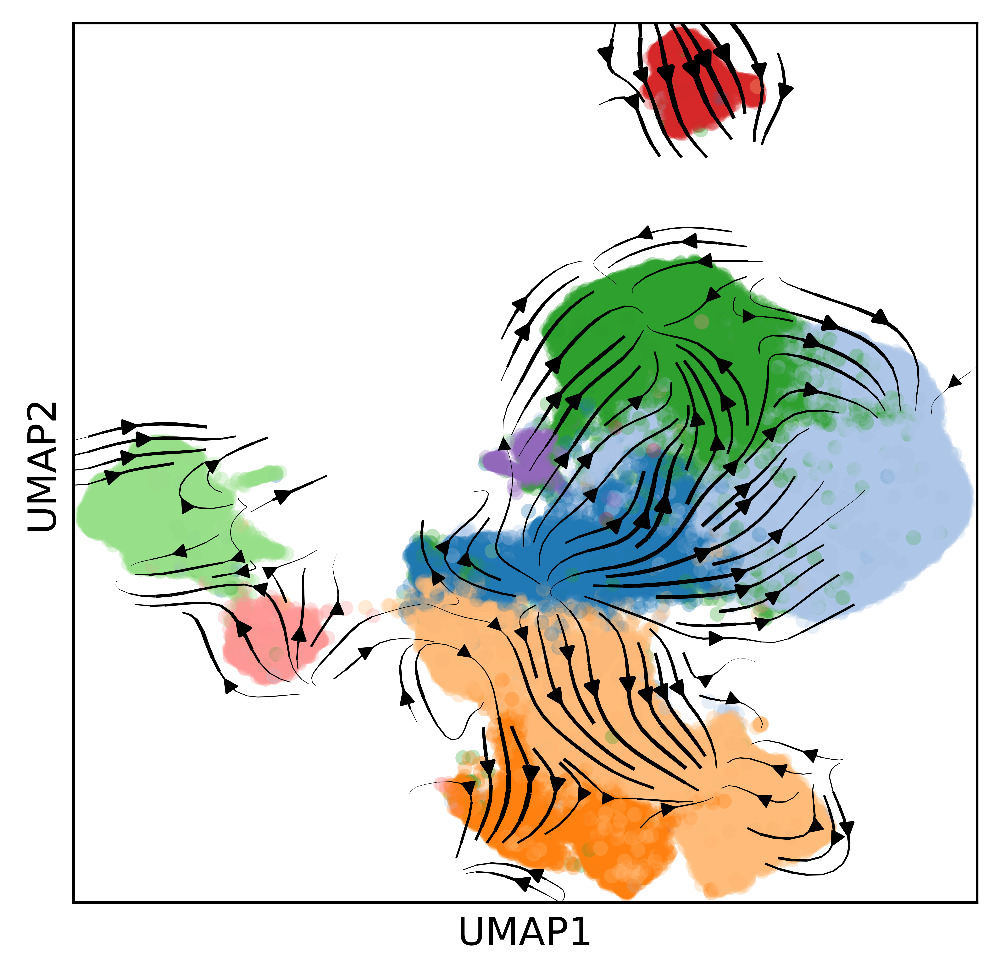

In [26]:
scv.pl.velocity_embedding_stream(adata_w_velo,
                                 basis='umap',
                                 legend_fontsize=12,
                                 title='', smooth=.8, min_mass=2,
                                 color = 'cell_subtype',
                                 figsize = (5,5),
                                 save = "velocity.png",
                                 dpi = 600,
                                 legend_loc = 'none')

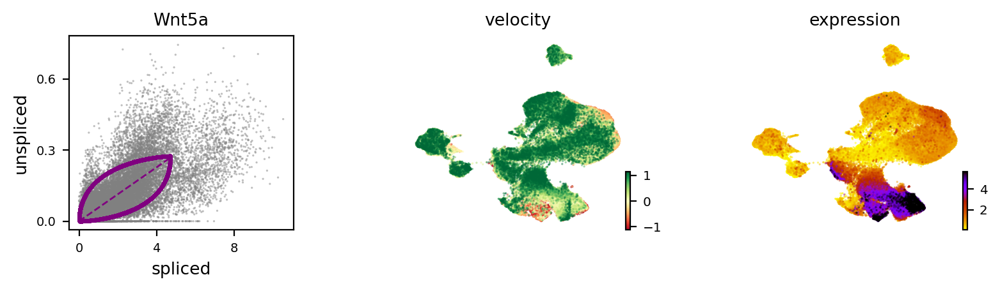

In [27]:
scv.pl.velocity(adata_w_velo, ['Wnt5a'], ncols=1)

## Start cellrank part

Identify terminal states

Play with estimators.


In [28]:
from cellrank.tl.kernels import VelocityKernel
from cellrank.tl.kernels import ConnectivityKernel

vk = VelocityKernel(adata_w_velo).compute_transition_matrix(seed = 42)
ck = ConnectivityKernel(adata_w_velo).compute_transition_matrix()


Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode



Setting `softmax_scale=11.3321`



    Finish (0:17:12)
Computing transition matrix based on connectivities
    Finish (0:00:00)


In [29]:
combined_kernel = 0.7 * vk + 0.3 * ck
print(combined_kernel)

((0.7 * <Velo[softmax_scale=11.33, mode=deterministic, seed=42, scheme=<CorrelationScheme>]>) + (0.3 * <Conn[dnorm=True]>))


In [30]:
from cellrank.tl.estimators import GPCCA
g = GPCCA(combined_kernel)
print(g)

GPCCA[n=58560, kernel=((0.7 * <Velo[softmax_scale=11.33, mode=deterministic, seed=42, scheme=<CorrelationScheme>]>) + (0.3 * <Conn[dnorm=True]>))]


Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[6, 19, 24, 26, 31, 33, 35, 39, 41, 43, 45, 47, 49, 55, 58, 60, 62, 64, 66, 70, 73, 75, 78, 81, 84, 86, 89, 92, 94, 96, 99]`
Adding `.eigendecomposition`
       `adata.uns['eig_fwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:48)


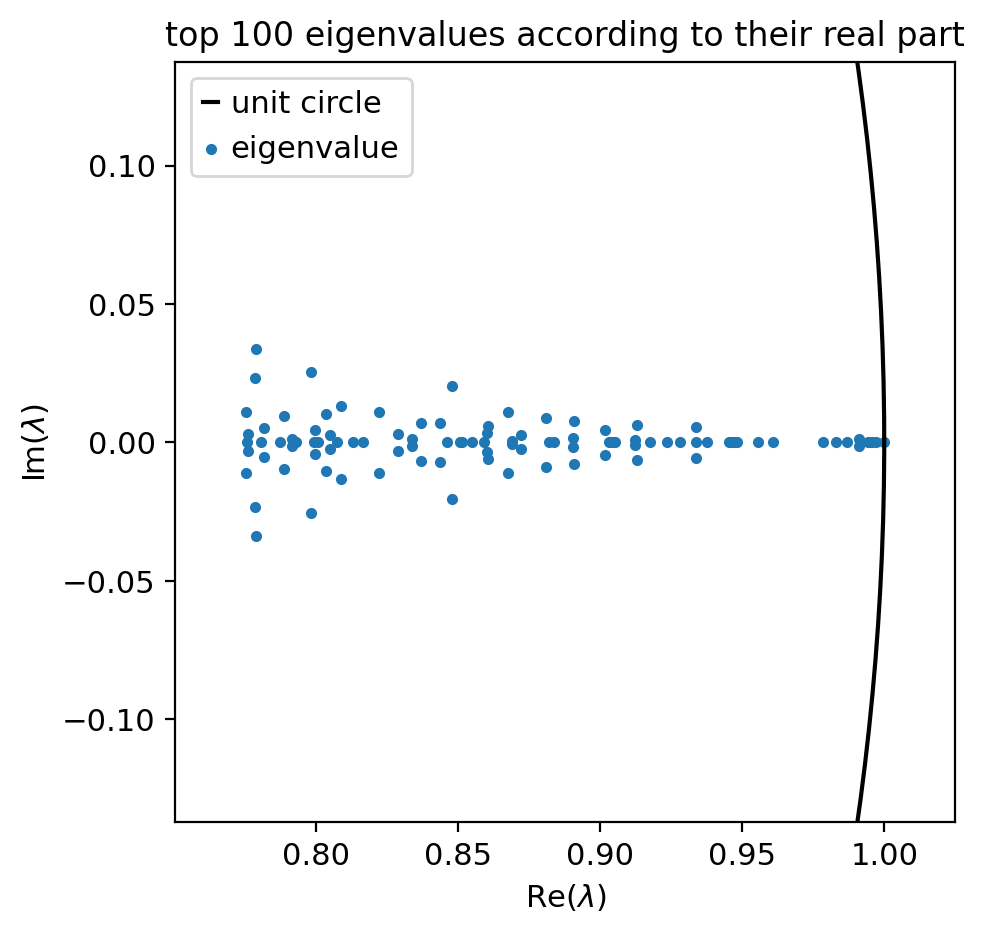

In [31]:
g.compute_schur(n_components=100)
g.plot_spectrum()

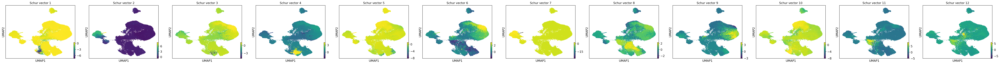

In [32]:
g.plot_schur(use=12)


Computing `10` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:01:37)


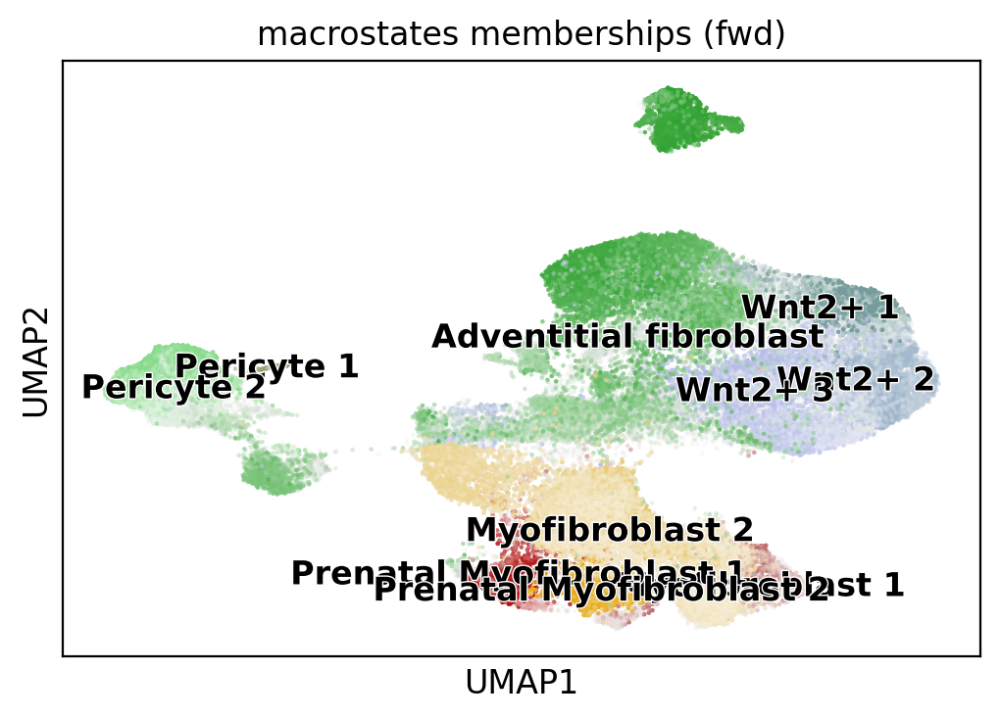

In [33]:
g.compute_macrostates(n_states=10, cluster_key='cell_subtype', n_cells = 120)
g.plot_macrostates()

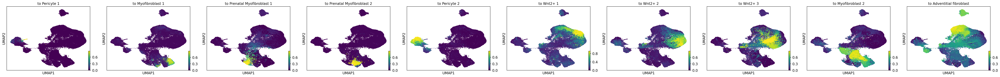

In [34]:
g.plot_macrostates(same_plot=False)

saving figure to file ./figures/scvelo_macrostates.png


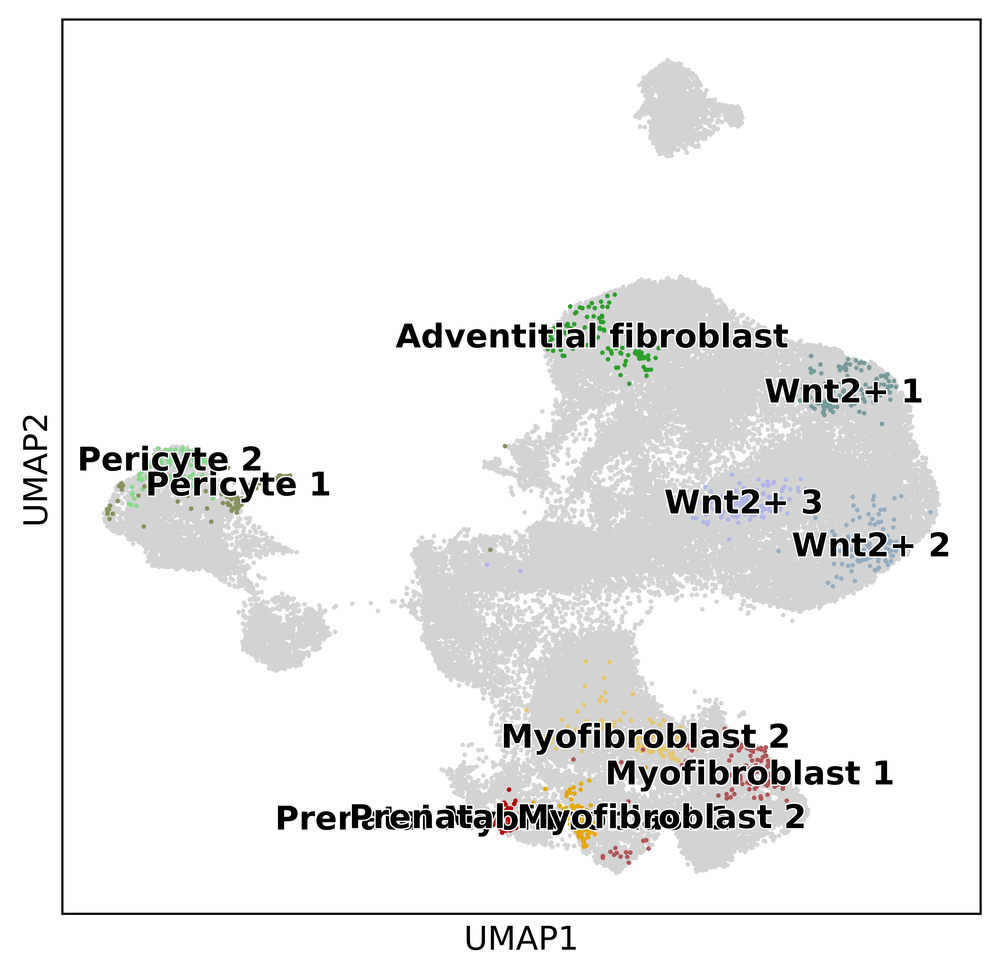

In [35]:
g.plot_macrostates(discrete=True,
                   title='',
                   figsize = (6,6),
                   save = "macrostates.png",
                   dpi = 600)


In [70]:
macrostates_list = list(g.macrostates.cat.categories)
#macrostates_list.remove("Wnt2+_1")
print(macrostates_list)

['Pericyte_1', 'Myofibroblast_1', 'Prenatal Myofibroblast_1', 'Prenatal Myofibroblast_2', 'Pericyte_2', 'Wnt2+_2', 'Wnt2+_3', 'Myofibroblast_2', 'Adventitial fibroblast']


In [71]:
# Drop out miEC1 - not many cells
#g.set_terminal_states_from_macrostates(names = ["Car4+", "miEC_1", "miEC_2",
#                                                "Venous maEC", "Arterial maEC",
#                                                "Lymphatic_1", "Lymphatic_2"])

g.set_terminal_states_from_macrostates(names = macrostates_list)

Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`


In [72]:
g.compute_absorption_probabilities()

Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:16:54)


Computing lineage probabilities towards terminal states
Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:17:41)
Adding lineages to `adata.obsm['to_terminal_states']`
    Finish (0:17:42)


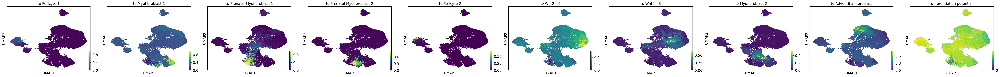

In [73]:
cr.tl.lineages(adata_w_velo)
cr.pl.lineages(adata_w_velo, same_plot=False)

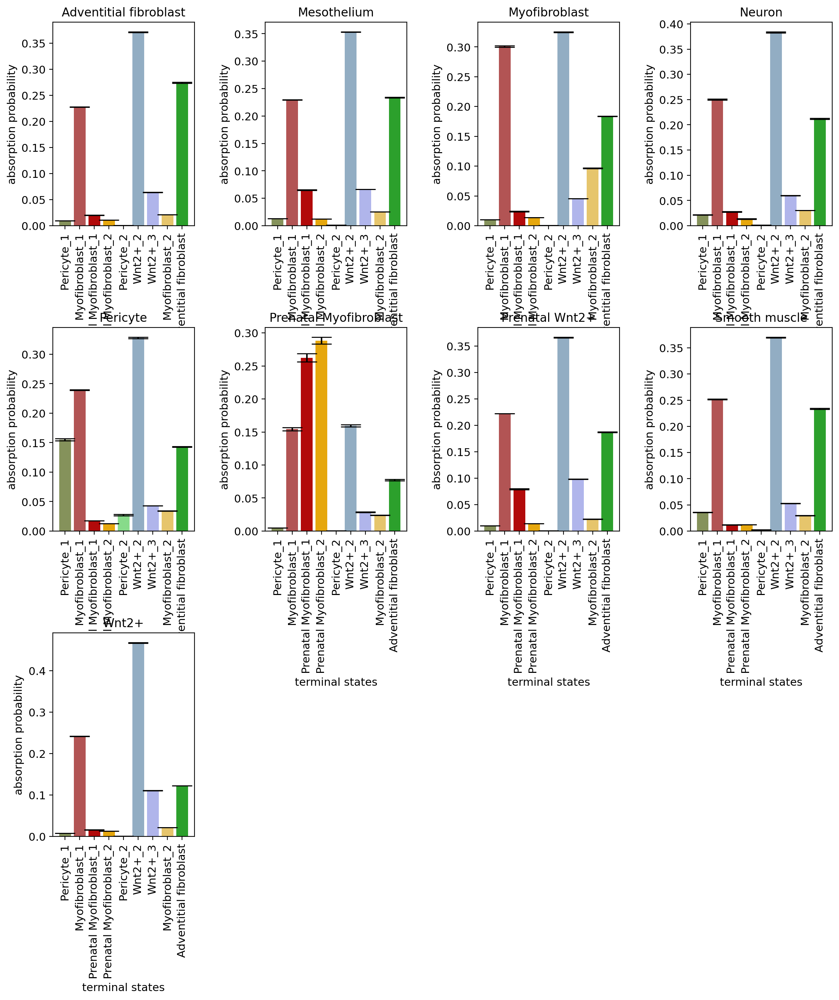

In [74]:
cr.pl.cluster_fates(adata_w_velo, mode="bar", cluster_key='cell_subtype', backward = False)

## Now, for finding initial states (run backwards)

In [40]:
vk_b = VelocityKernel(adata_w_velo, backward = True).compute_transition_matrix(seed = 42)
ck_b = ConnectivityKernel(adata_w_velo, backward = True).compute_transition_matrix()

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode



Setting `softmax_scale=11.3321`



    Finish (0:28:53)
Computing transition matrix based on connectivities
    Finish (0:00:00)


In [41]:
combined_kernel_b = 0.2 * vk_b + 0.8 * ck_b

In [42]:
g_b = GPCCA(combined_kernel_b)

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[13, 15, 18, 24, 31, 44, 52, 55, 57, 59, 64, 66, 70, 74, 79, 84, 88, 90]`
Adding `.eigendecomposition`
       `adata.uns['eig_bwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:04:34)


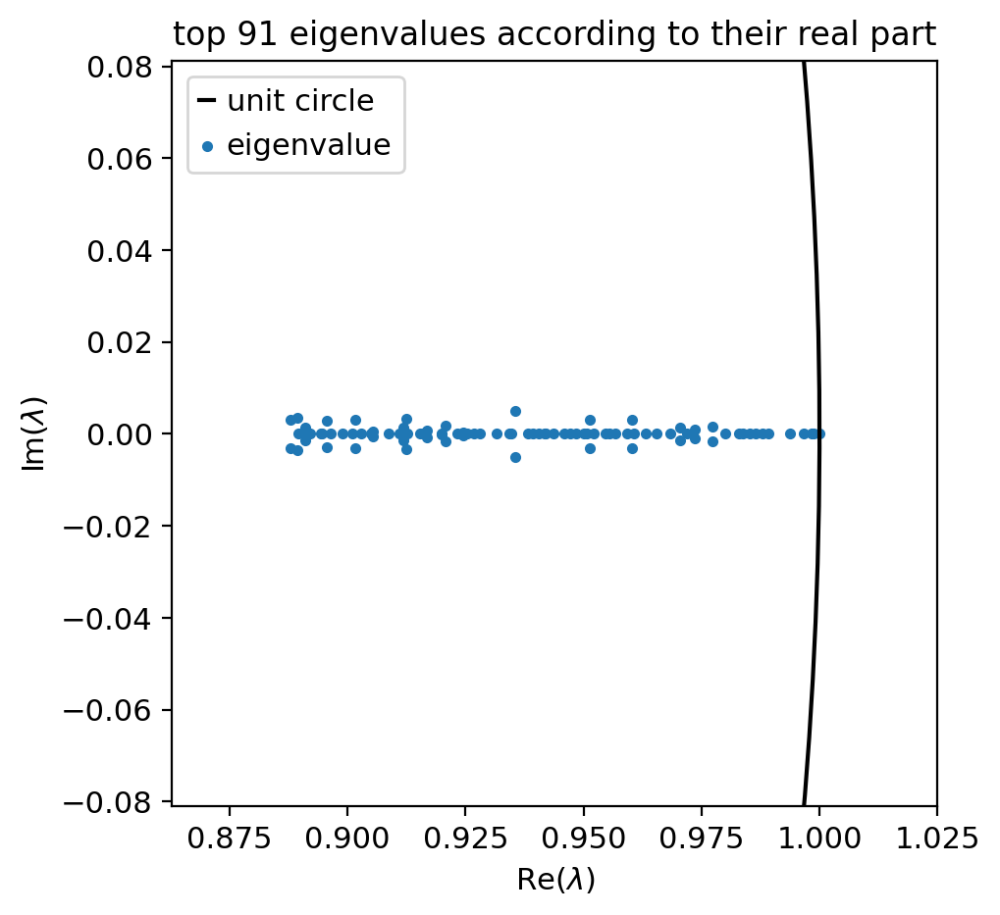

In [43]:
# n = 50 and 8 components is okay.. w/ n_cells = 90 / 120
# 30 captures most everything.. except prenatal wnt2
g_b.compute_schur(n_components=90)
g_b.plot_spectrum()

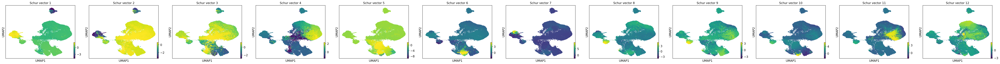

In [44]:
g_b.plot_schur(use=12)

Computing `9` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:01:33)


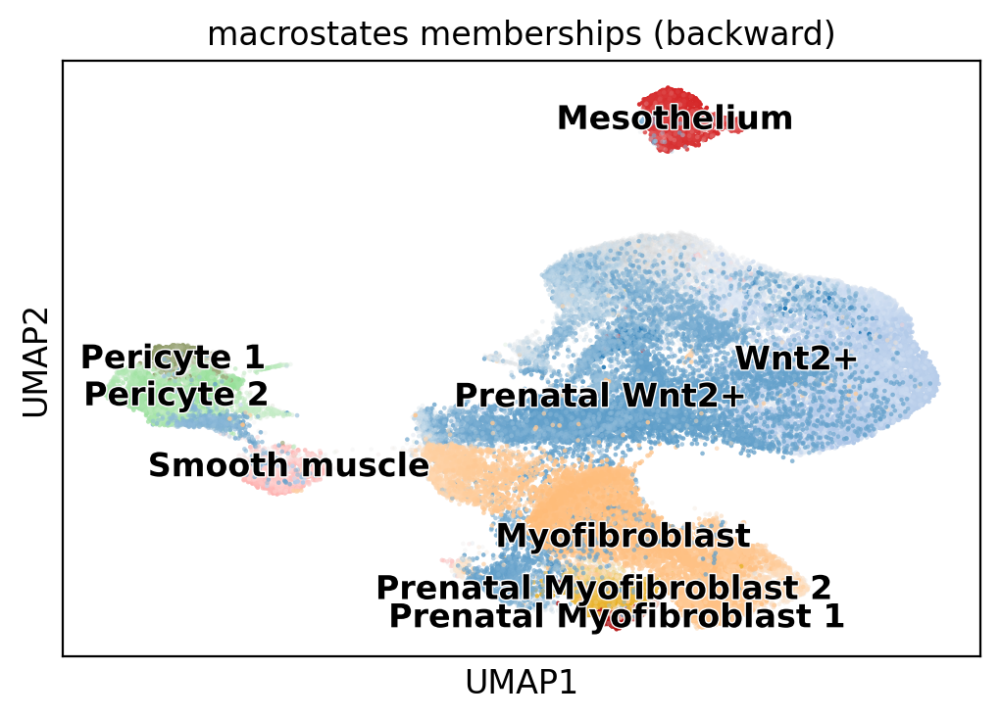

In [45]:
# 16 works
g_b.compute_macrostates(n_states=9, cluster_key='cell_subtype', n_cells = 120)
g_b.plot_macrostates()

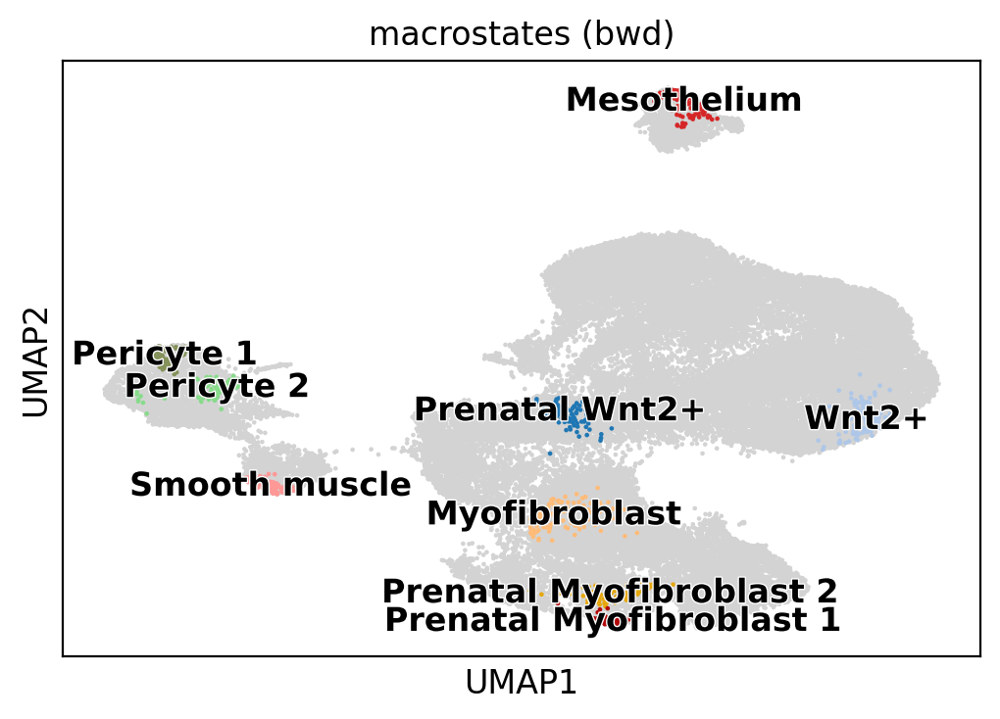

In [46]:
g_b.plot_macrostates(discrete = True)

In [47]:
macrostates_list = list(g_b.macrostates.cat.categories)
#macrostates_list.remove("Mesothelium")

In [48]:
#g_b.set_terminal_states_from_macrostates(names = ['Primordial', 'Secretory'])
g_b.set_terminal_states_from_macrostates(names = macrostates_list)
g_b.compute_absorption_probabilities()

Adding `adata.obs['initial_states_probs']`
       `adata.obs['initial_states']`
       `adata.obsm['macrostates_bwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
Computing absorption probabilities
Adding `adata.obsm['from_initial_states']`
       `adata.obs['from_initial_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:16:33)


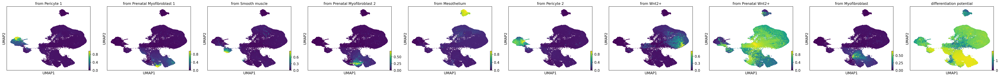

In [49]:
cr.pl.lineages(adata_w_velo, same_plot=False, backward = True)

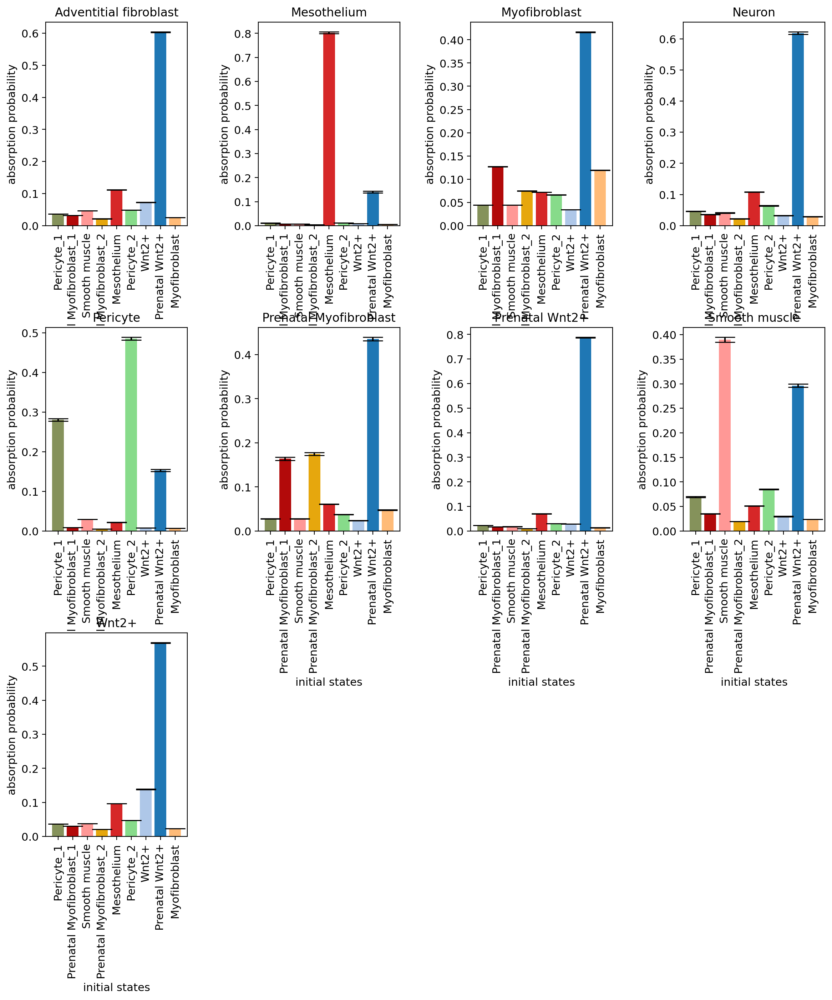

In [50]:
cr.pl.cluster_fates(adata_w_velo, mode="bar", cluster_key='cell_subtype', backward = True)

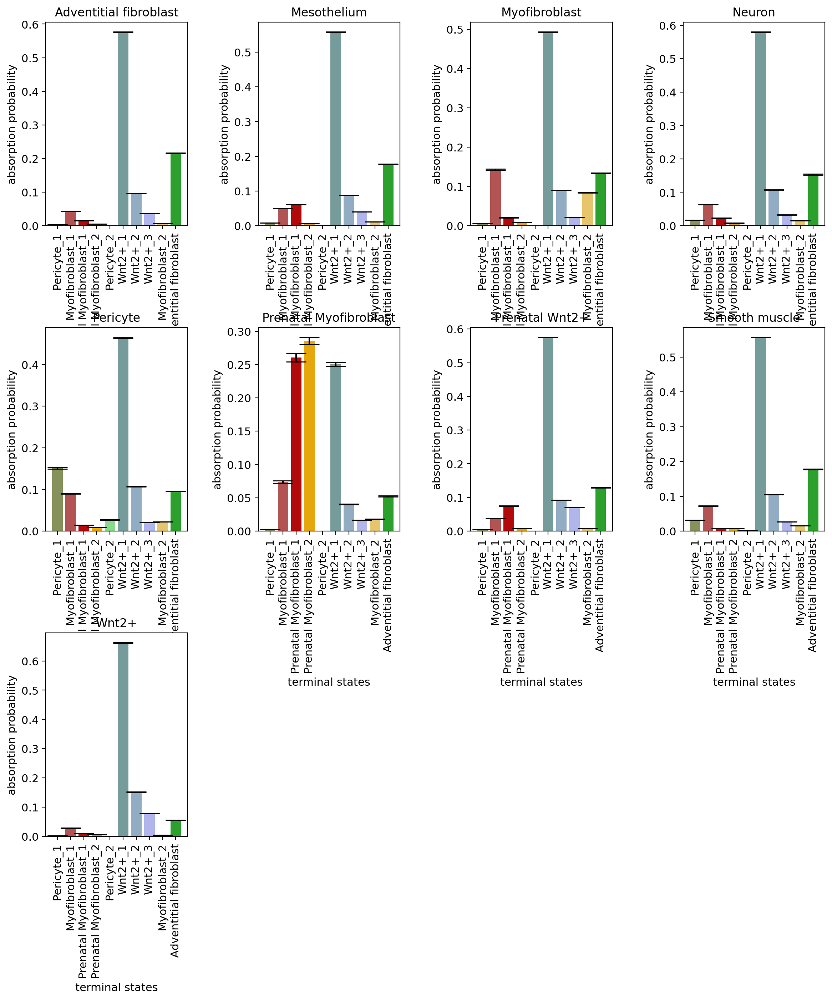

In [51]:
cr.pl.cluster_fates(adata_w_velo, mode="bar", cluster_key='cell_subtype', backward = False)

In [52]:
#adata_w_velo = anndata.read_h5ad("./intermediate_before_latent_time.h5ad")

In [53]:
adata_w_velo

AnnData object with n_obs × n_vars = 58560 × 21781
    obs: 'timepoint', 'bulk_cellype', 'cell_subtype', 'sample_batch', 'Clusters', '_X', '_Y', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'clusters_gradients', 'terminal_states', 'terminal_states_probs', 'to_terminal_states_dp', 'initial_states', 'initial_states_probs', 'from_initial_states_dp'
    var: 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_alignment_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'velocity_genes', 'fit_r2', 'fit_diff_kinetics', 'fit_pval_kinetics'
    uns: 'cell_subtype_colors', 'timepoint_colors', 'pca', 'neighbors', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'T_fwd_params', 'eig_fwd', 'clusters_gradients_colors', 'terminal_states_colors', 'terminal_states_names', 'to_terminal_states_names', 'to_terminal_states_colors', 'T_bwd_params'

In [54]:
scv.tl.velocity_confidence(adata_w_velo)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


In [55]:
adata_lite = anndata.AnnData(X=None,
                             obs = adata_w_velo.obs,
                             var = adata_w_velo.var,
                             uns = adata_w_velo.uns,
                             obsm = adata_w_velo.obsm,
                             varm = adata_w_velo.varm)

In [56]:
keys = ['to_terminal_states_names', 'from_initial_states_names', 'initial_states_names', 'terminal_states_names']
out_dict = {}
for key in keys:
    out_dict[key] = list(adata_lite.uns[key])
    
print(out_dict)
adata_lite.uns = out_dict

{'to_terminal_states_names': ['Pericyte_1', 'Myofibroblast_1', 'Prenatal Myofibroblast_1', 'Prenatal Myofibroblast_2', 'Pericyte_2', 'Wnt2+_1', 'Wnt2+_2', 'Wnt2+_3', 'Myofibroblast_2', 'Adventitial fibroblast'], 'from_initial_states_names': ['Pericyte_1', 'Prenatal Myofibroblast_1', 'Smooth muscle', 'Prenatal Myofibroblast_2', 'Mesothelium', 'Pericyte_2', 'Wnt2+', 'Prenatal Wnt2+', 'Myofibroblast'], 'initial_states_names': ['Pericyte_1', 'Prenatal Myofibroblast_1', 'Smooth muscle', 'Prenatal Myofibroblast_2', 'Mesothelium', 'Pericyte_2', 'Wnt2+', 'Prenatal Wnt2+', 'Myofibroblast'], 'terminal_states_names': ['Pericyte_1', 'Myofibroblast_1', 'Prenatal Myofibroblast_1', 'Prenatal Myofibroblast_2', 'Pericyte_2', 'Wnt2+_1', 'Wnt2+_2', 'Wnt2+_3', 'Myofibroblast_2', 'Adventitial fibroblast']}


In [57]:
adata_lite.write("./only_metadata.h5ad", compression = 'gzip')

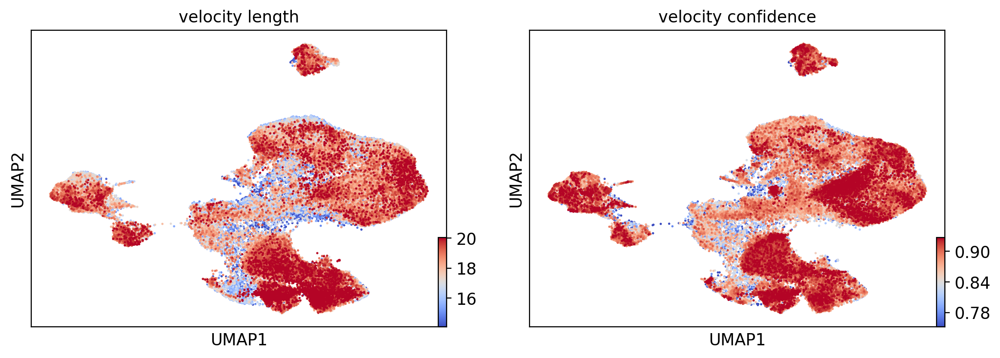

In [58]:
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(adata_w_velo, c=keys, cmap='coolwarm', perc=[5, 95])


In [59]:
adata_w_velo.write("./intermediate_before_latent_time.h5ad", compression = 'gzip') # gzip brings this from 20gb to 3gb

In [60]:
adata_onelayer = adata_w_velo
keys = ['velocity', 'fit_t']
layers_out_dict = {}
for key in keys:
    layers_out_dict[key] = adata_w_velo.layers[key]
    
layers_out_dict
adata_onelayer.layers = layers_out_dict
adata_w_velo.write("./removed_layers_before_latent_time.h5ad", compression = 'gzip') # gzip brings this from 20gb to 3gb

In [50]:
# On the mesenchyme, this needs > 128gb memory
#scv.tl.recover_latent_time(
#    adata_w_velo, root_key="initial_states_probs", end_key="terminal_states_probs"
#)

ValueError: color key is invalid! pass valid observation annotation or a gene name

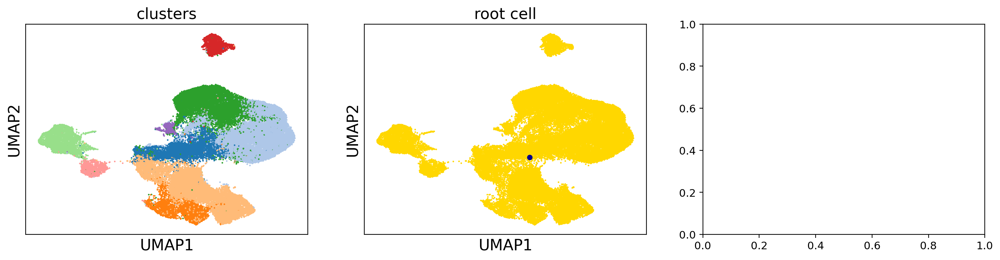

In [51]:
# compue dpt, starting from CellRank defined root cell
root_idx = np.where(adata_w_velo.obs['initial_states'] == 'Prenatal Wnt2+')[0][0]
adata_w_velo.uns['iroot'] = root_idx
sc.tl.dpt(adata_w_velo)

scv.pl.scatter(adata_w_velo, color=['cell_subtype', root_idx, 'latent_time', 'dpt_pseudotime'], fontsize=16,
               cmap='viridis', perc=[2, 98], colorbar=True, rescale_color=[0, 1],
               title=['clusters', 'root cell', 'dpt pseudotime'])

In [ ]:
scv.pl.scatter(adata_w_velo, color=['latent_time'], fontsize=16,
               cmap='viridis', perc=[2, 98], colorbar=True, rescale_color=[0, 1],
               title=['latent time'])

In [ ]:
scv.tl.paga(
    adata_w_velo,
    groups="cell_subtype",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="velocity_pseudotime",
)

In [ ]:
cr.pl.cluster_fates(
    adata_w_velo,
    mode="paga",
    cluster_key="cell_subtype",
    basis="umap",
    legend_kwargs={"loc": "bottom right"},
    legend_loc="on data",
    node_size_scale=5,
    edge_width_scale=1,
    max_edge_width=4,
    title="directed PAGA",
)

In [ ]:
cr.pl.cluster_fates(adata_w_velo, mode="paga_pie", cluster_key="cell_subtype", basis='umap',
                    legend_kwargs={'loc': 'top right out'}, legend_loc='top left out',
                    node_size_scale=5, edge_width_scale=1, max_edge_width=4, title='directed PAGA')

In [ ]:
scv.pl.proportions(adata_w_velo, groupby = "cell_subtype")

In [ ]:
scv.tl.score_genes_cell_cycle(adata_w_velo)
scv.pl.scatter(adata_w_velo, color_gradients=['S_score', 'G2M_score'],
               smooth=True, perc=[5, 95], palette='PuGn', # Yes, this throws an error - using it to reset colors
               figsize = (4,4),
               dpi = 600)


In [ ]:
scv.tl.velocity_confidence(adata_w_velo)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(adata_w_velo, c=keys, cmap='coolwarm', perc=[5, 95])


In [ ]:
scv.tl.velocity_pseudotime(adata_w_velo)
scv.pl.scatter(adata_w_velo, color='velocity_pseudotime', cmap='gnuplot')


In [ ]:
cr.tl.lineage_drivers(adata_w_velo)

In [ ]:
adata_w_velo.write("./after_cellrank.h5ad", compression = 'gzip') # gzip brings this from 20gb to 3gb

In [ ]:
adata_w_velo.var

In [ ]:
scv.pl.scatter(adata_w_velo, x='latent_time', y=['Tgfbi'], frameon=True, color = 'cell_subtype',
              layer = 'Ms')


In [ ]:
scv.pl.scatter(adata_w_velo, x='latent_time', y=['Wnt5a'], frameon=True, color = 'cell_subtype',
              layer = 'Ms')

In [76]:
adata_w_velo

AnnData object with n_obs × n_vars = 58560 × 21781
    obs: 'timepoint', 'bulk_cellype', 'cell_subtype', 'sample_batch', 'Clusters', '_X', '_Y', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'clusters_gradients', 'terminal_states', 'terminal_states_probs', 'to_terminal_states_dp', 'initial_states', 'initial_states_probs', 'from_initial_states_dp', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition'
    var: 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_alignment_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'velocity_genes', 'fit_r2', 'fit_diff_kinetics', 'fit_pval_kinetics'
    uns: 'cell_subtype_colors', 'timepoint_colors', 'pca', 'neighbors', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'T_fwd_params', 'eig_fwd', 'clusters_gradients_colors', 'terminal_states_colors', 'terminal_states_nam

In [75]:
import scipy.io
from scipy.sparse import csr_matrix
scipy.io.mmwrite('meso_expression_Ms.mtx', csr_matrix(adata_w_velo.layers['Ms']))

KeyError: 'Ms'